# Binary classification of MRI images
#### AUTHOR: TOMASZ SACHANOWSKI

In [1]:
import os
import pandas as pd

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense,Conv2D,MaxPooling2D,Flatten,Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping
from keras.preprocessing import image

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import os, shutil
from pathlib import Path
import random
from sklearn.metrics import roc_curve


In [2]:
def clear_dir(dir_name):
    for filename in os.listdir(dir_name):
        file_path = os.path.join(dir_name, filename)
        try:
            if os.path.isfile(file_path) or os.path.islink(file_path):
                os.unlink(file_path)
            elif os.path.isdir(file_path):
                shutil.rmtree(file_path)
        except Exception as e:
            print('Failed to delete %s. Reason: %s' % (file_path, e))

In [3]:
work_dir = r'C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/'
porownanie_modeli_dir =  r'C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli/'
model_glowny_dir = r'C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/'
step_catalogs = ["10", "20", "30", "40", "50", "60", "70", "80", "90"]
ilosc_filtorw = [32, 16, 8, 4]

In [4]:
clear_dir(model_glowny_dir)
for step_catalog in step_catalogs:
# #    clear_dir(os.path.join(model_dir + step_catalog))
    Path(model_glowny_dir + step_catalog + "/train/" + "clear").mkdir(parents=True, exist_ok=True)
    Path(model_glowny_dir + step_catalog + "/train/" + "artifacts").mkdir(parents=True, exist_ok=True)
    Path(model_glowny_dir + step_catalog + "/test/" + "clear").mkdir(parents=True, exist_ok=True)
    Path(model_glowny_dir + step_catalog + "/test/" + "artifacts").mkdir(parents=True, exist_ok=True)
    Path(model_glowny_dir + step_catalog + "/validation/" + "clear").mkdir(parents=True, exist_ok=True)
    Path(model_glowny_dir + step_catalog + "/validation/" + "artifacts").mkdir(parents=True, exist_ok=True)
#    Path(model_glowny_dir + step_catalog + "/model/").mkdir(parents=True, exist_ok=True)

In [5]:
procentage = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
clear_number = len(os.listdir(work_dir+"clear"))
artifacts_number = len(os.listdir(work_dir+"artifacts"))

procentage_clear = [int(i*clear_number) for i in procentage]
procentage_artifacts = [int(i*artifacts_number) for i in procentage]


In [6]:
procentage_clear, procentage_artifacts

([28, 57, 85, 114, 142, 171, 199, 228, 256],
 [29, 59, 89, 119, 149, 178, 208, 238, 268])

In [7]:
clear_files_index_steps = []
artifacts_files_index_steps = []
for number_of_files in procentage_clear:
    a = random.sample(range(len(os.listdir(work_dir+"clear"))), k=number_of_files)
    clear_files_index_steps.append(a)
for number_of_files in procentage_artifacts:
    a = random.sample(range(len(os.listdir(work_dir+"artifacts"))), k=number_of_files)
    artifacts_files_index_steps.append(a)

In [8]:
for indx, step_catalog in enumerate(step_catalogs):
    for file_index, file_name in enumerate(os.listdir(work_dir + "clear/")):
        if file_index not in clear_files_index_steps[indx]:
            if file_index%2:
                shutil.copy2(work_dir + "clear/" + file_name, model_glowny_dir + step_catalog + "/test/" + "clear/")
            else:
                shutil.copy2(work_dir + "clear/" + file_name, model_glowny_dir + step_catalog + "/validation/" + "clear/")
        else:
            shutil.copy2(work_dir + "clear/" + file_name, model_glowny_dir + step_catalog + "/train/" + "clear/")

for indx, step_catalog in enumerate(step_catalogs):
    for file_index, file_name in enumerate(os.listdir(work_dir+"artifacts/")):
        if file_index not in artifacts_files_index_steps[indx]:
            if file_index%2:
                shutil.copy2(work_dir + "artifacts/" + file_name, model_glowny_dir + step_catalog + "/test/" + "artifacts/")
            else:
                shutil.copy2(work_dir + "artifacts/" + file_name, model_glowny_dir + step_catalog + "/validation/" + "artifacts/")
        else:
            shutil.copy2(work_dir + "artifacts/" + file_name, model_glowny_dir + step_catalog + "/train/" + "artifacts/")

## Data augmentation

In [9]:
gen_parameters = {
    "rotation_range":45,
    "zoom_range":0.25,
    "horizontal_flip":True,
    "vertical_flip":True
}

In [10]:
flow_parameters ={
    "target_size":(256, 256),
    "color_mode":'grayscale',
    "class_mode":'binary',
    "batch_size": 32
}

In [11]:
# create Image generator for training, validation and test set.
data_gen = ImageDataGenerator(**gen_parameters)

In [12]:
train_generators = [
    data_gen.flow_from_directory(
        model_glowny_dir + step_catalog + "/train", **flow_parameters)for step_catalog in step_catalogs]

Found 57 images belonging to 2 classes.
Found 116 images belonging to 2 classes.
Found 174 images belonging to 2 classes.
Found 233 images belonging to 2 classes.
Found 291 images belonging to 2 classes.
Found 349 images belonging to 2 classes.
Found 407 images belonging to 2 classes.
Found 466 images belonging to 2 classes.
Found 524 images belonging to 2 classes.


In [13]:
validation_generators = [
    data_gen.flow_from_directory(
        model_glowny_dir + step_catalog + "/validation", **flow_parameters)for step_catalog in step_catalogs]

Found 260 images belonging to 2 classes.
Found 231 images belonging to 2 classes.
Found 204 images belonging to 2 classes.
Found 176 images belonging to 2 classes.
Found 150 images belonging to 2 classes.
Found 116 images belonging to 2 classes.
Found 94 images belonging to 2 classes.
Found 54 images belonging to 2 classes.
Found 27 images belonging to 2 classes.


In [14]:
test_generators = [
    data_gen.flow_from_directory(
        model_glowny_dir + step_catalog + "/test", **flow_parameters)for step_catalog in step_catalogs]

Found 266 images belonging to 2 classes.
Found 236 images belonging to 2 classes.
Found 205 images belonging to 2 classes.
Found 174 images belonging to 2 classes.
Found 142 images belonging to 2 classes.
Found 118 images belonging to 2 classes.
Found 82 images belonging to 2 classes.
Found 63 images belonging to 2 classes.
Found 32 images belonging to 2 classes.


In [15]:
class_names = train_generators[0].class_indices
class_names

{'artifacts': 0, 'clear': 1}

## Presentation of images

32
32
25
25
32
32
25
25
32
32
25
25
32
32
25
25
32
32
32
32
32
32
32
32
20
20
32
32
32
32
32
32
20
20
32
32
32
32
32
32
32
32
32
32
32
32
14
14
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
9
9
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32


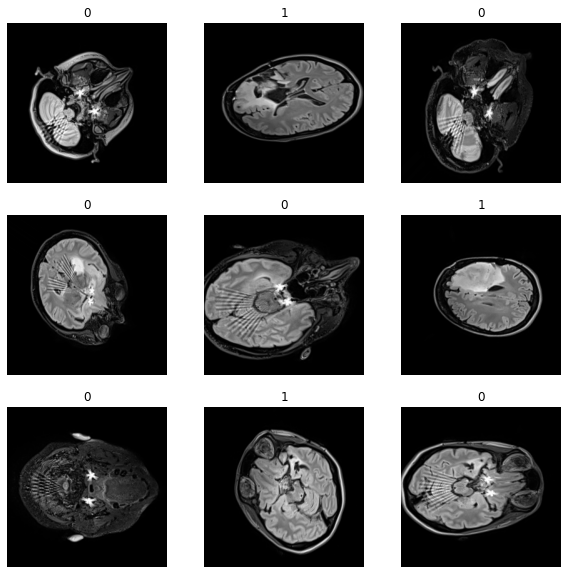

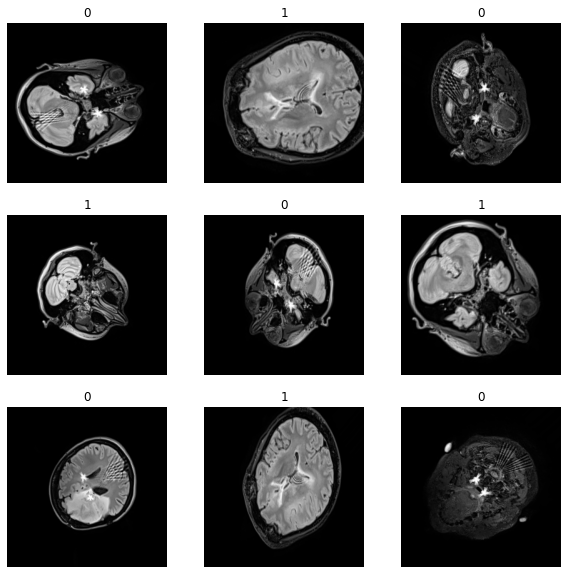

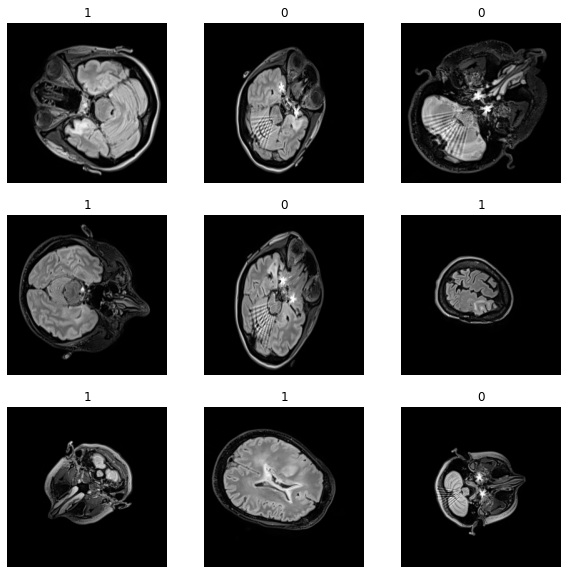

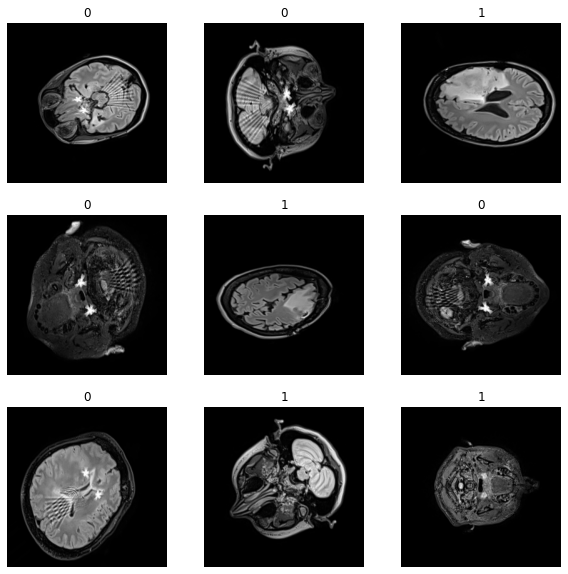

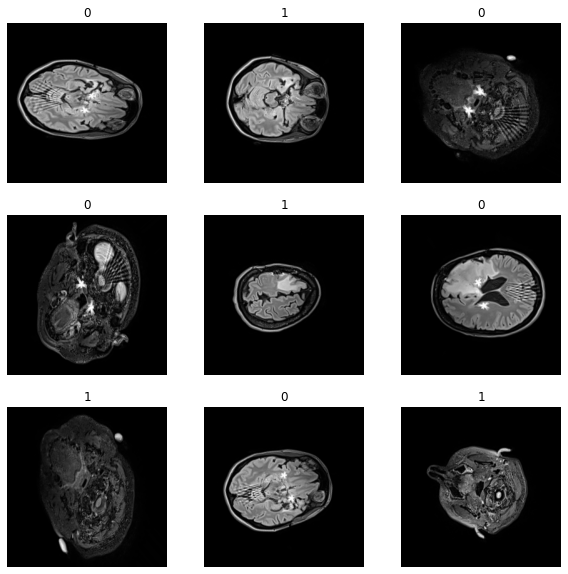

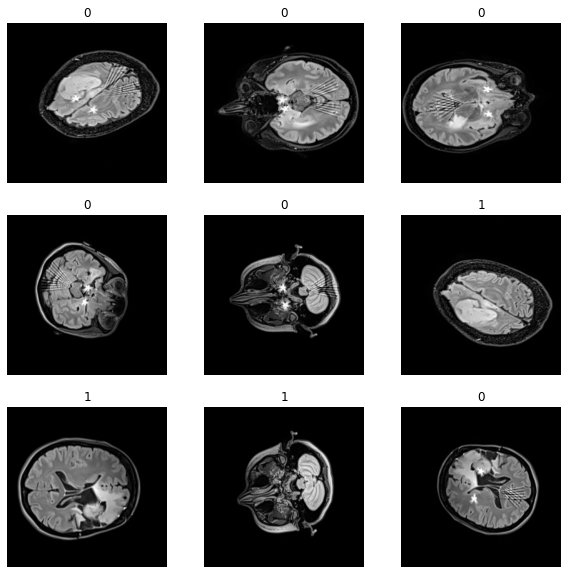

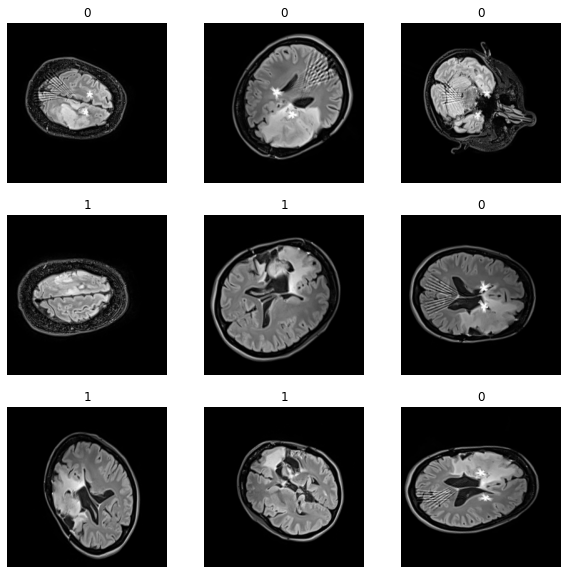

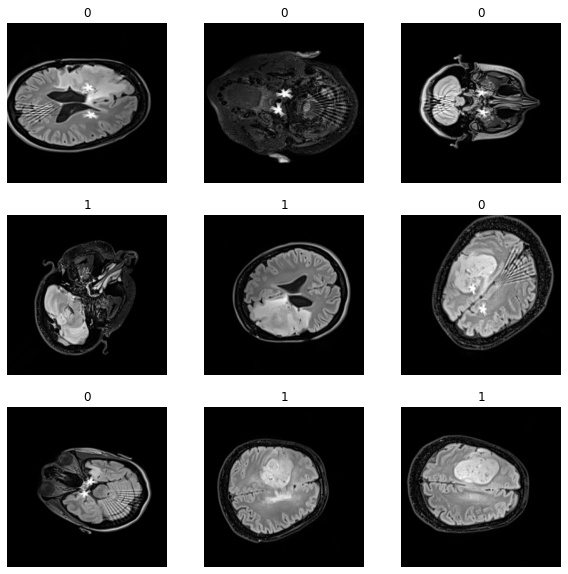

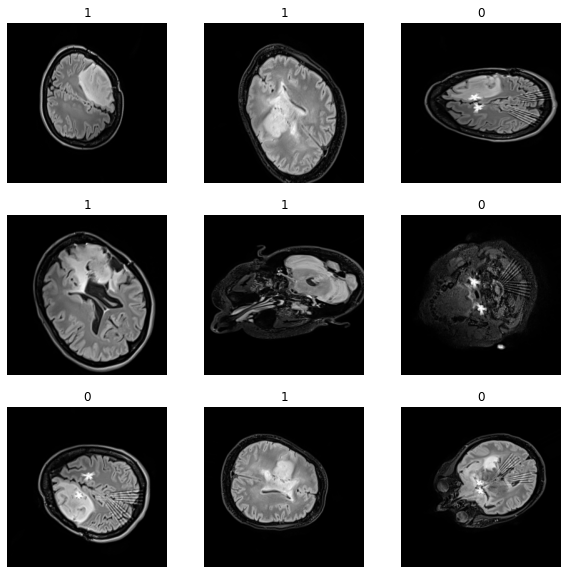

In [16]:
#%matplotlib notebook
#plt.figure(figsize=(10, 10))
for gen in train_generators:
    plt.figure(figsize=(10, 10))
    for i in range(9):
        images, labels = gen.next()
        print(len(images))
        print(len(labels))
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[0].astype("uint8"), cmap='gray')
        plt.title(int(labels[0]))
        plt.axis("off")

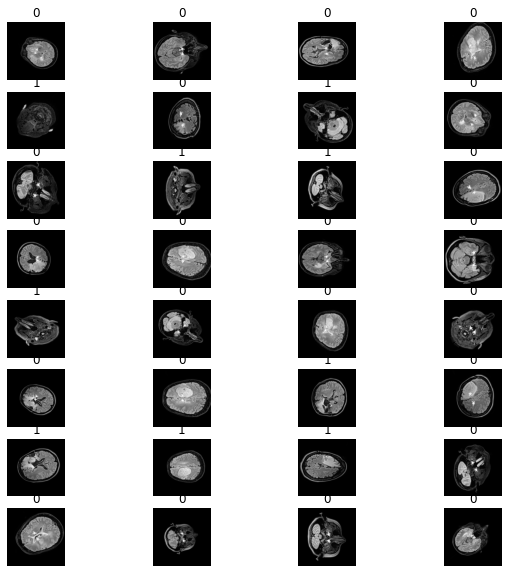

In [17]:
plt.figure(figsize=(10, 10))
images, labels = gen.next()
for i in range(32):
    ax = plt.subplot(8, 4, i + 1)
    plt.imshow(images[i].astype("uint8"), cmap='gray')
    plt.title(int(labels[i]))
    plt.axis("off")

## Build the convolutional neural network

In [17]:
METRICS = [
      keras.metrics.BinaryAccuracy(name='accuracy'),
#       keras.metrics.TruePositives(name='tp'),
#       keras.metrics.FalsePositives(name='fp'),
#       keras.metrics.TrueNegatives(name='tn'),
#       keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
#       keras.metrics.AUC(name='prc', curve='PR')
]

In [18]:
models = []
history = []
for indx, step_catalog in enumerate(step_catalogs):
    model = Sequential([
        tf.keras.layers.experimental.preprocessing.Rescaling(1./255),

        Conv2D(filters=32,kernel_size=(3,3), activation='relu'),
        MaxPooling2D(pool_size=(2,2)),

        Conv2D(filters=32,kernel_size=(3,3), activation='relu'),
        MaxPooling2D(pool_size=(2,2)),
    #     Dropout(0.25),

        Conv2D(filters=32,kernel_size=(3,3), activation='relu'),
        MaxPooling2D(pool_size=(2,2)),

    #    Dropout(0.2),

        Flatten(),
        Dense(64, activation='relu'),
        Dropout(0.2),
        Dense(1, activation='sigmoid')
    ])

    model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=model_glowny_dir + step_catalog + '/checkpoint',
        save_weights_only=False,
        monitor='val_loss', 
        mode='min', # mam loss wiec min
        save_best_only=True)

    callbacks = [
             EarlyStopping(patience=5),
             model_checkpoint_callback
    ]
    model.compile(optimizer='adam',
                  loss=keras.losses.BinaryCrossentropy(from_logits=True),
                  metrics=METRICS)

    hist = model.fit(train_generators[indx], validation_data=validation_generators[indx],
    epochs=60, callbacks=callbacks)

    history.append(hist)
    models.append(model)

Epoch 1/60


C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


2/2 [==============================] - 4s 3s/step - loss: 0.6907 - accuracy: 0.4561 - precision: 0.4516 - recall: 0.5000 - auc: 0.4895 - val_loss: 0.6992 - val_accuracy: 0.5498 - val_precision: 0.5291 - val_recall: 0.7519 - val_auc: 0.5362
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/10\checkpoint\assets
Epoch 2/60
2/2 [==============================] - 1s 1s/step - loss: 0.7163 - accuracy: 0.5088 - precision: 0.5000 - recall: 0.8929 - auc: 0.5634 - val_loss: 0.6950 - val_accuracy: 0.5240 - val_precision: 0.5135 - val_recall: 0.5714 - val_auc: 0.5487
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/10\checkpoint\assets
Epoch 3/60
2/2 [==============================] - 1s 1s/step - loss: 0.7136 - accuracy: 0.5263 - precision: 0.5200 - recall: 0.4643 - auc: 0.4748 - val_loss: 0.6947 - val_accuracy: 0.5240 - val_precision: 0.8333 - val_recall: 0.0376 - val_auc: 0.5690
INFO:tensorflow:As

Epoch 51/60
2/2 [==============================] - 1s 1s/step - loss: 0.0829 - accuracy: 1.0000 - precision: 1.0000 - recall: 1.0000 - auc: 1.0000 - val_loss: 0.1413 - val_accuracy: 0.9446 - val_precision: 1.0000 - val_recall: 0.8872 - val_auc: 0.9980
Epoch 52/60
2/2 [==============================] - 1s 1s/step - loss: 0.1106 - accuracy: 0.9474 - precision: 0.9630 - recall: 0.9286 - auc: 0.9963 - val_loss: 0.1036 - val_accuracy: 0.9705 - val_precision: 0.9771 - val_recall: 0.9624 - val_auc: 0.9970
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/10\checkpoint\assets
Epoch 53/60
2/2 [==============================] - 1s 1s/step - loss: 0.1528 - accuracy: 0.9474 - precision: 0.9032 - recall: 1.0000 - auc: 0.9895 - val_loss: 0.1537 - val_accuracy: 0.9410 - val_precision: 0.8980 - val_recall: 0.9925 - val_auc: 0.9940
Epoch 54/60
2/2 [==============================] - 1s 1s/step - loss: 0.1564 - accuracy: 0.9123 - precision: 0.8710 - recall

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


4/4 [==============================] - 4s 870ms/step - loss: 0.7232 - accuracy: 0.8088 - precision: 0.8333 - recall: 0.7632 - auc: 0.9323 - val_loss: 0.6950 - val_accuracy: 0.4912 - val_precision: 0.4912 - val_recall: 1.0000 - val_auc: 0.4325
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/20\checkpoint\assets
Epoch 2/60
4/4 [==============================] - 1s 408ms/step - loss: 0.6959 - accuracy: 0.5000 - precision: 0.4957 - recall: 1.0000 - auc: 0.4153 - val_loss: 0.6924 - val_accuracy: 0.5833 - val_precision: 0.5503 - val_recall: 0.8304 - val_auc: 0.5749
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/20\checkpoint\assets
Epoch 3/60
4/4 [==============================] - 1s 385ms/step - loss: 0.6952 - accuracy: 0.4914 - precision: 0.4545 - recall: 0.1754 - auc: 0.4941 - val_loss: 0.6909 - val_accuracy: 0.5088 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.6149
I

INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/20\checkpoint\assets
Epoch 25/60
4/4 [==============================] - 1s 423ms/step - loss: 0.5089 - accuracy: 0.7500 - precision: 0.8182 - recall: 0.6316 - auc: 0.8510 - val_loss: 0.4404 - val_accuracy: 0.8509 - val_precision: 0.8482 - val_recall: 0.8482 - val_auc: 0.9097
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/20\checkpoint\assets
Epoch 26/60
4/4 [==============================] - 1s 393ms/step - loss: 0.4766 - accuracy: 0.8276 - precision: 0.7681 - recall: 0.9298 - auc: 0.8794 - val_loss: 0.4483 - val_accuracy: 0.8158 - val_precision: 0.9268 - val_recall: 0.6786 - val_auc: 0.9149
Epoch 27/60
4/4 [==============================] - 1s 398ms/step - loss: 0.4330 - accuracy: 0.8190 - precision: 0.9091 - recall: 0.7018 - auc: 0.9175 - val_loss: 0.4475 - val_accuracy: 0.8158 - val_precision: 0.7465 - val_recall: 0.9464 - val_auc: 0.

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


6/6 [==============================] - 3s 526ms/step - loss: 0.7144 - accuracy: 0.7189 - precision: 0.7333 - recall: 0.6701 - auc: 0.8375 - val_loss: 0.7003 - val_accuracy: 0.4776 - val_precision: 0.4745 - val_recall: 0.9789 - val_auc: 0.4792
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/30\checkpoint\assets
Epoch 2/60
6/6 [==============================] - 2s 268ms/step - loss: 0.6950 - accuracy: 0.5057 - precision: 0.4964 - recall: 0.8118 - auc: 0.5116 - val_loss: 0.6885 - val_accuracy: 0.5522 - val_precision: 0.5243 - val_recall: 0.5684 - val_auc: 0.5848
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/30\checkpoint\assets
Epoch 3/60
6/6 [==============================] - 2s 262ms/step - loss: 0.6908 - accuracy: 0.5575 - precision: 0.6053 - recall: 0.2706 - auc: 0.5346 - val_loss: 0.6788 - val_accuracy: 0.5274 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.7115
I

INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/30\checkpoint\assets
Epoch 25/60
6/6 [==============================] - 1s 280ms/step - loss: 0.0798 - accuracy: 0.9655 - precision: 0.9647 - recall: 0.9647 - auc: 0.9980 - val_loss: 0.0935 - val_accuracy: 0.9602 - val_precision: 0.9307 - val_recall: 0.9895 - val_auc: 0.9990
Epoch 26/60
6/6 [==============================] - 1s 257ms/step - loss: 0.0768 - accuracy: 0.9770 - precision: 0.9880 - recall: 0.9647 - auc: 0.9982 - val_loss: 0.2113 - val_accuracy: 0.8756 - val_precision: 0.7917 - val_recall: 1.0000 - val_auc: 1.0000
Epoch 27/60
6/6 [==============================] - 2s 268ms/step - loss: 0.1875 - accuracy: 0.9195 - precision: 0.9494 - recall: 0.8824 - auc: 0.9837 - val_loss: 0.1749 - val_accuracy: 0.9254 - val_precision: 0.8636 - val_recall: 1.0000 - val_auc: 1.0000
Epoch 28/60
6/6 [==============================] - 1s 262ms/step - loss: 0.2374 - accuracy: 0.8851 - precision: 0.8

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


8/8 [==============================] - 3s 359ms/step - loss: 0.7251 - accuracy: 0.7097 - precision: 0.6797 - recall: 0.7512 - auc: 0.8064 - val_loss: 0.7026 - val_accuracy: 0.4689 - val_precision: 0.4689 - val_recall: 1.0000 - val_auc: 0.5102
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/40\checkpoint\assets
Epoch 2/60
8/8 [==============================] - 2s 210ms/step - loss: 0.6927 - accuracy: 0.5236 - precision: 0.5211 - recall: 0.3246 - auc: 0.5407 - val_loss: 0.6840 - val_accuracy: 0.5367 - val_precision: 1.0000 - val_recall: 0.0120 - val_auc: 0.7356
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/40\checkpoint\assets
Epoch 3/60
8/8 [==============================] - 2s 214ms/step - loss: 0.6866 - accuracy: 0.5708 - precision: 0.7500 - recall: 0.1842 - auc: 0.5918 - val_loss: 0.6819 - val_accuracy: 0.5367 - val_precision: 0.5135 - val_recall: 0.2289 - val_auc: 0.6342
INFO:tens

Epoch 24/60
8/8 [==============================] - 2s 218ms/step - loss: 0.1395 - accuracy: 0.9571 - precision: 0.9561 - recall: 0.9561 - auc: 0.9914 - val_loss: 0.1493 - val_accuracy: 0.9435 - val_precision: 0.9398 - val_recall: 0.9398 - val_auc: 0.9927
Epoch 25/60
8/8 [==============================] - 2s 214ms/step - loss: 0.1149 - accuracy: 0.9614 - precision: 0.9646 - recall: 0.9561 - auc: 0.9942 - val_loss: 0.1850 - val_accuracy: 0.9379 - val_precision: 1.0000 - val_recall: 0.8675 - val_auc: 0.9876
Epoch 26/60
8/8 [==============================] - 2s 232ms/step - loss: 0.1536 - accuracy: 0.9313 - precision: 0.9375 - recall: 0.9211 - auc: 0.9856 - val_loss: 0.1236 - val_accuracy: 0.9718 - val_precision: 1.0000 - val_recall: 0.9398 - val_auc: 0.9937
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/40\checkpoint\assets
Epoch 27/60
8/8 [==============================] - 2s 226ms/step - loss: 0.1254 - accuracy: 0.9399 - precision: 0.9

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


10/10 [==============================] - 4s 314ms/step - loss: 0.6979 - accuracy: 0.7094 - precision: 0.7354 - recall: 0.6178 - auc: 0.8207 - val_loss: 0.6798 - val_accuracy: 0.5316 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.6730
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/50\checkpoint\assets
Epoch 2/60
10/10 [==============================] - 2s 184ms/step - loss: 0.6909 - accuracy: 0.5155 - precision: 0.5048 - recall: 0.3732 - auc: 0.5405 - val_loss: 0.6846 - val_accuracy: 0.5506 - val_precision: 1.0000 - val_recall: 0.0405 - val_auc: 0.6310
Epoch 3/60
10/10 [==============================] - 2s 183ms/step - loss: 0.6797 - accuracy: 0.5326 - precision: 0.7143 - recall: 0.0704 - auc: 0.6786 - val_loss: 0.6700 - val_accuracy: 0.5696 - val_precision: 1.0000 - val_recall: 0.0811 - val_auc: 0.7232
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/50\checkpoint\as

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


11/11 [==============================] - 4s 335ms/step - loss: 0.7101 - accuracy: 0.6647 - precision: 0.7072 - recall: 0.5224 - auc: 0.7815 - val_loss: 0.6896 - val_accuracy: 0.5122 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.6532
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/60\checkpoint\assets
Epoch 2/60
11/11 [==============================] - 2s 173ms/step - loss: 0.6917 - accuracy: 0.4986 - precision: 0.4615 - recall: 0.1404 - auc: 0.5546 - val_loss: 0.6913 - val_accuracy: 0.5528 - val_precision: 0.5806 - val_recall: 0.3000 - val_auc: 0.5443
Epoch 3/60
11/11 [==============================] - 2s 170ms/step - loss: 0.6885 - accuracy: 0.5501 - precision: 0.5372 - recall: 0.5906 - auc: 0.5776 - val_loss: 0.6865 - val_accuracy: 0.5528 - val_precision: 1.0000 - val_recall: 0.0833 - val_auc: 0.7082
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/60\checkpoint\as

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


13/13 [==============================] - 4s 256ms/step - loss: 0.6868 - accuracy: 0.6321 - precision: 0.7424 - recall: 0.3784 - auc: 0.7459 - val_loss: 0.6927 - val_accuracy: 0.5385 - val_precision: 0.5393 - val_recall: 0.9796 - val_auc: 0.4898
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/70\checkpoint\assets
Epoch 2/60
13/13 [==============================] - 2s 151ms/step - loss: 0.6930 - accuracy: 0.4963 - precision: 0.4817 - recall: 0.3970 - auc: 0.5169 - val_loss: 0.6920 - val_accuracy: 0.4615 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.7051
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/70\checkpoint\assets
Epoch 3/60
13/13 [==============================] - 2s 160ms/step - loss: 0.6971 - accuracy: 0.5135 - precision: 1.0000 - recall: 0.0050 - auc: 0.5019 - val_loss: 0.6874 - val_accuracy: 0.4615 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


15/15 [==============================] - 4s 230ms/step - loss: 0.7015 - accuracy: 0.5889 - precision: 0.5750 - recall: 0.6643 - auc: 0.6460 - val_loss: 0.6909 - val_accuracy: 0.5102 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.5858
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/80\checkpoint\assets
Epoch 2/60
15/15 [==============================] - 2s 135ms/step - loss: 0.6900 - accuracy: 0.5107 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.5790 - val_loss: 0.6929 - val_accuracy: 0.5102 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.5642
Epoch 3/60
15/15 [==============================] - 2s 134ms/step - loss: 0.6876 - accuracy: 0.5129 - precision: 1.0000 - recall: 0.0044 - auc: 0.6244 - val_loss: 0.6823 - val_accuracy: 0.5102 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.8042
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


17/17 [==============================] - 4s 214ms/step - loss: 0.6937 - accuracy: 0.5567 - precision: 0.5528 - recall: 0.4857 - auc: 0.6167 - val_loss: 0.6970 - val_accuracy: 0.4286 - val_precision: 0.5000 - val_recall: 0.3125 - val_auc: 0.4896
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/90\checkpoint\assets
Epoch 2/60
17/17 [==============================] - 2s 128ms/step - loss: 0.6809 - accuracy: 0.5668 - precision: 0.5986 - recall: 0.3438 - auc: 0.6020 - val_loss: 0.7157 - val_accuracy: 0.5000 - val_precision: 0.5385 - val_recall: 0.8750 - val_auc: 0.3385
Epoch 3/60
17/17 [==============================] - 2s 133ms/step - loss: 0.6539 - accuracy: 0.6050 - precision: 0.6433 - recall: 0.4297 - auc: 0.6913 - val_loss: 0.5999 - val_accuracy: 0.7857 - val_precision: 0.7273 - val_recall: 1.0000 - val_auc: 0.9375
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/model_glowny/90\checkpoint\assets
Epo

##  Visualize a deep learning model 

In [19]:
model.summary()

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_8 (Rescaling)      (None, None, None, None)  0         
_________________________________________________________________
conv2d_24 (Conv2D)           (None, None, None, 32)    320       
_________________________________________________________________
max_pooling2d_24 (MaxPooling (None, None, None, 32)    0         
_________________________________________________________________
conv2d_25 (Conv2D)           (None, None, None, 32)    9248      
_________________________________________________________________
max_pooling2d_25 (MaxPooling (None, None, None, 32)    0         
_________________________________________________________________
conv2d_26 (Conv2D)           (None, None, None, 32)    9248      
_________________________________________________________________
max_pooling2d_26 (MaxPooling (None, None, None, 32)   

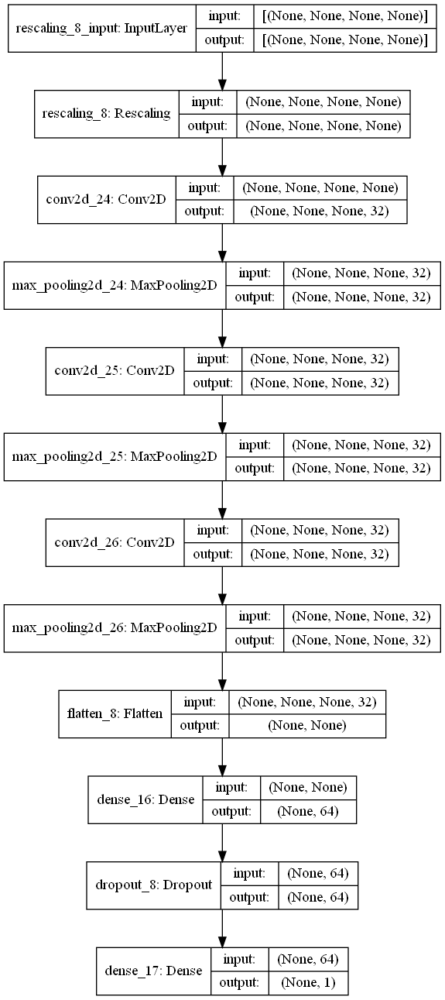

In [20]:
tf.keras.utils.plot_model(
    model,
    to_file=model_glowny_dir+ "/model.png",
    show_shapes=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=True,
    dpi=96,
)

## Monitoring the model’s performance


In [21]:
# Funkcja straty
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie funkcji straty modelu glownego przy zwiekszajacym sie zbiorze treningowym', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(history):
    metrics_df = pd.DataFrame(hist.history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.0))
    ax.plot(metrics_df[["loss","val_loss"]])
    ax.legend(["loss","val_loss"])
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + 'Zachowanie funkcji straty modelu glownego przy zwiekszajacym sie zbiorze treningowym.png')

In [22]:
# Dokladnosc modelu
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie funkcji dokladnosci modelu glownego przy zwiekszajacym sie zbiorze treningowym', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(history):
    metrics_df = pd.DataFrame(hist.history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["accuracy","val_accuracy"]])
    ax.legend(["accuracy","val_accuracy"])
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + 'Zachowanie funkcji dokladnosci modelu glownego przy zwiekszajacym sie zbiorze treningowym.png')

In [23]:
# Precyzyjnosc modelu
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie precyzyjnosci modelu glownego przy zwiekszajacym sie zbiorze treningowym', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(history):
    metrics_df = pd.DataFrame(hist.history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["precision","val_precision"]])
    ax.legend(["precision","val_precision"])
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + 'Zachowanie precyzyjnosci modelu glownego przy zwiekszajacym sie zbiorze treningowym.png')

In [24]:
#Czulosc modelu
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie czulosci modelu glownego przy zwiekszajacym sie zbiorze treningowym', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(history):
    metrics_df = pd.DataFrame(hist.history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["recall","val_recall"]])
    ax.legend(["recall","val_recall"])
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + 'Zachowanie czulosci modelu glownego przy zwiekszajacym sie zbiorze treningowym.png')

In [25]:
#AUC modelu
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie AUC modelu glownego przy zwiekszajacym sie zbiorze treningowym', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(history):
    metrics_df = pd.DataFrame(hist.history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["auc","val_auc"]])
    ax.legend(["auc","val_auc"])
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + 'Zachowanie AUC modelu glownego przy zwiekszajacym sie zbiorze treningowym.png')

## Checking the performance of the model on the validation set.

In [28]:
val_results = []
for indx, model in enumerate(models):
    res = model.evaluate(validation_generators[indx])
    val_results.append(res)

1/1 [==============================] - 0s 148ms/step - loss: 0.0025 - accuracy: 1.0000 - precision: 1.0000 - recall: 1.0000 - auc: 1.0000


## Checking the model on the test set.

In [29]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
test_results = []
for indx, model in enumerate(models):
    res = model.evaluate(test_generators[indx])
    test_results.append(res)

Evaluate on test data
1/1 [==============================] - 0s 148ms/step - loss: 0.0205 - accuracy: 1.0000 - precision: 1.0000 - recall: 1.0000 - auc: 1.0000


In [30]:
fpr_models = []
tpr_models = []
for indx, model in enumerate(models):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_generators[indx].next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))


        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The percentage training set {} True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(step_catalogs[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models.append(fpr)
    tpr_models.append(tpr)


The percentage training set 10 True positive: 177 True negative: 202 False Positive: 21 False negative: 0

The percentage training set 20 True positive: 213 True negative: 153 False Positive: 34 False negative: 0

The percentage training set 30 True positive: 192 True negative: 177 False Positive: 30 False negative: 1

The percentage training set 40 True positive: 203 True negative: 192 False Positive: 3 False negative: 2

The percentage training set 50 True positive: 218 True negative: 181 False Positive: 1 False negative: 0

The percentage training set 60 True positive: 197 True negative: 200 False Positive: 3 False negative: 0

The percentage training set 70 True positive: 192 True negative: 200 False Positive: 8 False negative: 0

The percentage training set 80 True positive: 172 True negative: 199 False Positive: 3 False negative: 26

The percentage training set 90 True positive: 152 True negative: 245 False Positive: 3 False negative: 0



In [34]:
#ROC modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models[indx] , tpr_models[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Procentowa wielkosc zbioru treningowego {}%".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + 'Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym.png')

## Dane z tego samego generatora

In [35]:
fpr_models = []
tpr_models = []
for indx, model in enumerate(models):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_generators[5].next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))


        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The percentage training set {} True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(step_catalogs[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models.append(fpr)
    tpr_models.append(tpr)


The percentage training set 10 True positive: 195 True negative: 181 False Positive: 24 False negative: 0

The percentage training set 20 True positive: 185 True negative: 164 False Positive: 50 False negative: 1

The percentage training set 30 True positive: 196 True negative: 165 False Positive: 39 False negative: 0

The percentage training set 40 True positive: 176 True negative: 216 False Positive: 6 False negative: 2

The percentage training set 50 True positive: 178 True negative: 218 False Positive: 3 False negative: 1

The percentage training set 60 True positive: 196 True negative: 200 False Positive: 3 False negative: 1

The percentage training set 70 True positive: 184 True negative: 201 False Positive: 15 False negative: 0

The percentage training set 80 True positive: 172 True negative: 200 False Positive: 1 False negative: 27

The percentage training set 90 True positive: 219 True negative: 180 False Positive: 1 False negative: 0



In [37]:
#ROC modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models[indx] , tpr_models[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + 'Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy tym samym genratorze.png')

In [38]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
test_results = []
for indx, model in enumerate(models):
    res = model.evaluate(test_generators[5])
    test_results.append(res)

Evaluate on test data
4/4 [==============================] - 0s 92ms/step - loss: 0.0041 - accuracy: 1.0000 - precision: 1.0000 - recall: 1.0000 - auc: 1.0000


## Test gdy dane oddalone o 10 w prawo

In [42]:
path_1 = model_glowny_dir + "test_10_oddalone_w_prawo/"
test_1 = data_gen.flow_from_directory(path_1, **flow_parameters)

Found 433 images belonging to 2 classes.


In [43]:
fpr_models = []
tpr_models = []
for indx, model in enumerate(models):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_1.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))

        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The percentage training set {} True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(step_catalogs[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models.append(fpr)
    tpr_models.append(tpr)


The percentage training set 10 True positive: 204 True negative: 29 False Positive: 167 False negative: 0

The percentage training set 20 True positive: 209 True negative: 14 False Positive: 176 False negative: 1

The percentage training set 30 True positive: 205 True negative: 25 False Positive: 170 False negative: 0

The percentage training set 40 True positive: 210 True negative: 66 False Positive: 121 False negative: 3

The percentage training set 50 True positive: 211 True negative: 85 False Positive: 104 False negative: 0

The percentage training set 60 True positive: 211 True negative: 91 False Positive: 97 False negative: 1

The percentage training set 70 True positive: 210 True negative: 30 False Positive: 160 False negative: 0

The percentage training set 80 True positive: 186 True negative: 109 False Positive: 80 False negative: 25

The percentage training set 90 True positive: 206 True negative: 85 False Positive: 109 False negative: 0



In [44]:
#ROC modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models[indx] , tpr_models[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + "test_10_oddalone_w_prawo/" + 'Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow.png')

In [46]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
test_results = []
for indx, model in enumerate(models):
    res = model.evaluate(test_1)
    test_results.append(res)

Evaluate on test data
14/14 [==============================] - 2s 120ms/step - loss: 0.7881 - accuracy: 0.7344 - precision: 0.6647 - recall: 1.0000 - auc: 0.9488


## Test gdy dane oddalone o 20 w prawo

In [48]:
path_2 = model_glowny_dir + "test_20_oddalone_w_prawo/"
test_2 = data_gen.flow_from_directory(path_2, **flow_parameters)

Found 427 images belonging to 2 classes.


In [49]:
fpr_models = []
tpr_models = []
for indx, model in enumerate(models):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_2.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))


        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The percentage training set {} True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(step_catalogs[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models.append(fpr)
    tpr_models.append(tpr)


The percentage training set 10 True positive: 216 True negative: 22 False Positive: 161 False negative: 1

The percentage training set 20 True positive: 205 True negative: 1 False Positive: 193 False negative: 1

The percentage training set 30 True positive: 217 True negative: 0 False Positive: 183 False negative: 0

The percentage training set 40 True positive: 208 True negative: 1 False Positive: 187 False negative: 4

The percentage training set 50 True positive: 221 True negative: 20 False Positive: 159 False negative: 0

The percentage training set 60 True positive: 210 True negative: 2 False Positive: 188 False negative: 0

The percentage training set 70 True positive: 229 True negative: 1 False Positive: 170 False negative: 0

The percentage training set 80 True positive: 181 True negative: 14 False Positive: 181 False negative: 24

The percentage training set 90 True positive: 210 True negative: 18 False Positive: 172 False negative: 0



In [50]:
#ROC modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models[indx] , tpr_models[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + "test_20_oddalone_w_prawo/" + 'Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow.png')

In [51]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
test_results = []
for indx, model in enumerate(models):
    res = model.evaluate(test_2)
    test_results.append(res)

Evaluate on test data
14/14 [==============================] - 2s 121ms/step - loss: 2.1199 - accuracy: 0.5738 - precision: 0.5561 - recall: 1.0000 - auc: 0.7274


## Test gdy dane nie maja prazkow

In [52]:
path_3 = model_glowny_dir + "test_brak_prazkow/"
test_3 = data_gen.flow_from_directory(path_3, **flow_parameters)

Found 421 images belonging to 2 classes.


In [53]:
fpr_models = []
tpr_models = []
for indx, model in enumerate(models):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_3.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))
    #     print(class_info, prediction)
    #     plt.imshow(images[0].astype("uint8"), cmap='gray')
    #     plt.show()


        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The percentage training set {} True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(step_catalogs[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models.append(fpr)
    tpr_models.append(tpr)
#     ax = plt.subplot(9, 1, indx + 1)
#     ax.plot([0, 1], [0, 1], 'k--')
#     ax.plot(fpr_keras, tpr_keras, 'r')
#     plt.xlabel('False positive rate')
#     plt.ylabel('True positive rate')
#     plt.title('The percentage training set {}- ROC curve'.format(step_catalogs[indx]))
# plt.show()

The percentage training set 10 True positive: 214 True negative: 40 False Positive: 146 False negative: 0

The percentage training set 20 True positive: 239 True negative: 136 False Positive: 25 False negative: 0

The percentage training set 30 True positive: 216 True negative: 163 False Positive: 21 False negative: 0

The percentage training set 40 True positive: 220 True negative: 176 False Positive: 2 False negative: 2

The percentage training set 50 True positive: 228 True negative: 166 False Positive: 5 False negative: 1

The percentage training set 60 True positive: 215 True negative: 185 False Positive: 0 False negative: 0

The percentage training set 70 True positive: 199 True negative: 118 False Positive: 83 False negative: 0

The percentage training set 80 True positive: 203 True negative: 178 False Positive: 0 False negative: 19

The percentage training set 90 True positive: 208 True negative: 184 False Positive: 8 False negative: 0



In [54]:
#ROC modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models[indx] , tpr_models[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + "test_brak_prazkow/" + 'Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow.png')

In [55]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
test_results = []
for indx, model in enumerate(models):
    res = model.evaluate(test_3)
    test_results.append(res)

Evaluate on test data
14/14 [==============================] - 2s 114ms/step - loss: 0.0547 - accuracy: 0.9762 - precision: 0.9580 - recall: 1.0000 - auc: 1.0000


## Test gdy jest jedna gwiazka

In [56]:
path_4 = model_glowny_dir + "test_jedna_gwiazda/"
test_4 = data_gen.flow_from_directory(path_4, **flow_parameters)

Found 499 images belonging to 2 classes.


In [57]:
fpr_models = []
tpr_models = []
for indx, model in enumerate(models):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_4.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))
    #     print(class_info, prediction)
    #     plt.imshow(images[0].astype("uint8"), cmap='gray')
    #     plt.show()


        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The percentage training set {} True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(step_catalogs[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models.append(fpr)
    tpr_models.append(tpr)
#     ax = plt.subplot(9, 1, indx + 1)
#     ax.plot([0, 1], [0, 1], 'k--')
#     ax.plot(fpr_keras, tpr_keras, 'r')
#     plt.xlabel('False positive rate')
#     plt.ylabel('True positive rate')
#     plt.title('The percentage training set {}- ROC curve'.format(step_catalogs[indx]))
# plt.show()

The percentage training set 10 True positive: 171 True negative: 98 False Positive: 130 False negative: 1

The percentage training set 20 True positive: 181 True negative: 111 False Positive: 107 False negative: 1

The percentage training set 30 True positive: 168 True negative: 104 False Positive: 128 False negative: 0

The percentage training set 40 True positive: 189 True negative: 169 False Positive: 40 False negative: 2

The percentage training set 50 True positive: 172 True negative: 216 False Positive: 12 False negative: 0

The percentage training set 60 True positive: 203 True negative: 185 False Positive: 12 False negative: 0

The percentage training set 70 True positive: 190 True negative: 119 False Positive: 91 False negative: 0

The percentage training set 80 True positive: 150 True negative: 216 False Positive: 11 False negative: 23

The percentage training set 90 True positive: 166 True negative: 204 False Positive: 30 False negative: 0



In [58]:
#ROC modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models[indx] , tpr_models[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Procentowa wielkosc zbioru treningowego {} %".format(step_catalogs[indx]))
plt.show()
fig.savefig(model_glowny_dir + "test_jedna_gwiazda/" + 'Zachowanie ROC modelu glownego przy zwiekszajacym sie zbiorze treningowym przy zbiorze testowym 400 elementow.png')

In [59]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
test_results = []
for indx, model in enumerate(models):
    res = model.evaluate(test_4)
    test_results.append(res)

Evaluate on test data
16/16 [==============================] - 2s 120ms/step - loss: 0.1649 - accuracy: 0.9379 - precision: 0.8803 - recall: 1.0000 - auc: 0.9977


## Porwnanie modeli

In [60]:
for i in ilosc_filtorw:
    clear_dir(porownanie_modeli_dir + "model_{}".format(i))

In [61]:
train_generator = data_gen.flow_from_directory(porownanie_modeli_dir + "/train", **flow_parameters)

Found 466 images belonging to 2 classes.


In [62]:
val_generator = data_gen.flow_from_directory(porownanie_modeli_dir + "/validation", **flow_parameters)

Found 65 images belonging to 2 classes.


In [63]:
test_generator = data_gen.flow_from_directory(porownanie_modeli_dir + "/test", **flow_parameters)

Found 52 images belonging to 2 classes.


In [ ]:
#%matplotlib notebook
#plt.figure(figsize=(10, 10))
plt.figure(figsize=(20, 20))
images, labels = gen.next()
for i in range(32):
    img = images[i]
    label = labels[i]
    ax = plt.subplot(4, 8, i + 1)
    plt.imshow(img.astype("uint8"), cmap='gray')
    plt.title(int(label))
    plt.axis("off")

In [64]:
models_filtres = []
history_filtres = []
for i in ilosc_filtorw:
    model = Sequential([
        tf.keras.layers.experimental.preprocessing.Rescaling(1./255),

        Conv2D(filters=i,kernel_size=(3,3), activation='relu'),
        MaxPooling2D(pool_size=(2,2)),

        Conv2D(filters=i, kernel_size=(3,3), activation='relu'),
        MaxPooling2D(pool_size=(2,2)),
    #     Dropout(0.25),

        Conv2D(filters=i, kernel_size=(3,3), activation='relu'),
        MaxPooling2D(pool_size=(2,2)),

    #    Dropout(0.2),

        Flatten(),
        Dense(64, activation='relu'),
        Dropout(0.2),
        Dense(1, activation='sigmoid')
    ])

    model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=porownanie_modeli_dir + "model_{}".format(i),
        save_weights_only=False,
        monitor='val_loss', 
        mode='min', # mam loss wiec min
        save_best_only=True)

    callbacks = [
             EarlyStopping(patience=5),
             model_checkpoint_callback
    ]
    model.compile(optimizer='adam',
                  loss=keras.losses.BinaryCrossentropy(from_logits=True),
                  metrics=METRICS)

    hist = model.fit(train_generator, validation_data=val_generator,
    epochs=60, callbacks=callbacks)

    history_filtres.append(hist)
    models_filtres.append(model)
    print("Finished model with filtres {}\n".format(i))

Epoch 1/60


C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


15/15 [==============================] - 3s 167ms/step - loss: 0.6971 - accuracy: 0.7326 - precision: 0.7240 - recall: 0.7018 - auc: 0.8550 - val_loss: 0.7030 - val_accuracy: 0.4462 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.7572
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_32\assets
Epoch 2/60
15/15 [==============================] - 2s 137ms/step - loss: 0.6864 - accuracy: 0.5386 - precision: 0.5359 - recall: 0.4254 - auc: 0.5669 - val_loss: 0.6996 - val_accuracy: 0.4462 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.8429
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_32\assets
Epoch 3/60
15/15 [==============================] - 2s 147ms/step - loss: 0.6900 - accuracy: 0.5923 - precision: 0.6173 - recall: 0.4386 - auc: 0.5878 - val_loss: 0.6729 - val_accuracy: 0.6923 - val_precision: 0.6538 - val_recall: 0.9444 - val

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


15/15 [==============================] - 4s 175ms/step - loss: 0.6952 - accuracy: 0.5819 - precision: 0.5890 - recall: 0.5265 - auc: 0.6234 - val_loss: 0.6961 - val_accuracy: 0.4462 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.7543
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_16\assets
Epoch 2/60
15/15 [==============================] - 2s 140ms/step - loss: 0.6863 - accuracy: 0.5300 - precision: 0.6216 - recall: 0.1009 - auc: 0.6178 - val_loss: 0.6824 - val_accuracy: 0.5538 - val_precision: 0.7692 - val_recall: 0.2778 - val_auc: 0.7850
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_16\assets
Epoch 3/60
15/15 [==============================] - 2s 141ms/step - loss: 0.6697 - accuracy: 0.5987 - precision: 0.7204 - recall: 0.2939 - auc: 0.6803 - val_loss: 0.6346 - val_accuracy: 0.8308 - val_precision: 0.9630 - val_recall: 0.7222 - val_auc: 0.

Finished model with filtres 16

Epoch 1/60


C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


15/15 [==============================] - 3s 165ms/step - loss: 0.6969 - accuracy: 0.6045 - precision: 0.5780 - recall: 0.7576 - auc: 0.6312 - val_loss: 0.6981 - val_accuracy: 0.4462 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.7170
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_8\assets
Epoch 2/60
15/15 [==============================] - 2s 141ms/step - loss: 0.6909 - accuracy: 0.5107 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.6039 - val_loss: 0.6962 - val_accuracy: 0.4462 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_auc: 0.7433
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_8\assets
Epoch 3/60
15/15 [==============================] - 2s 146ms/step - loss: 0.6860 - accuracy: 0.5107 - precision: 0.0000e+00 - recall: 0.0000e+00 - auc: 0.6989 - val_loss: 0.6881 - val_accuracy: 0.4462 - val_precision: 0.0000e+00 - val_re

Epoch 25/60
15/15 [==============================] - 2s 142ms/step - loss: 0.0383 - accuracy: 0.9893 - precision: 0.9869 - recall: 0.9912 - auc: 0.9995 - val_loss: 0.0260 - val_accuracy: 1.0000 - val_precision: 1.0000 - val_recall: 1.0000 - val_auc: 1.0000
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_8\assets
Epoch 26/60
15/15 [==============================] - 2s 134ms/step - loss: 0.0757 - accuracy: 0.9657 - precision: 0.9649 - recall: 0.9649 - auc: 0.9966 - val_loss: 0.0218 - val_accuracy: 1.0000 - val_precision: 1.0000 - val_recall: 1.0000 - val_auc: 1.0000
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_8\assets
Epoch 27/60
15/15 [==============================] - 2s 143ms/step - loss: 0.0619 - accuracy: 0.9785 - precision: 0.9698 - recall: 0.9868 - auc: 0.9983 - val_loss: 0.0295 - val_accuracy: 0.9846 - val_precision: 0.9730 - val_recall: 1.0000 - val_auc

C:\Users\tomeczek\AppData\Roaming\Python\Python38\site-packages\keras\backend.py:4993: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


15/15 [==============================] - 4s 189ms/step - loss: 0.7004 - accuracy: 0.5913 - precision: 0.5887 - recall: 0.5909 - auc: 0.6350 - val_loss: 0.6849 - val_accuracy: 0.5538 - val_precision: 0.5538 - val_recall: 1.0000 - val_auc: 0.5115
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_4\assets
Epoch 2/60
15/15 [==============================] - 2s 139ms/step - loss: 0.6763 - accuracy: 0.5386 - precision: 0.5747 - recall: 0.2193 - auc: 0.6425 - val_loss: 0.6860 - val_accuracy: 0.4615 - val_precision: 1.0000 - val_recall: 0.0278 - val_auc: 0.7768
Epoch 3/60
15/15 [==============================] - 2s 139ms/step - loss: 0.6540 - accuracy: 0.6073 - precision: 0.7586 - recall: 0.2895 - auc: 0.7664 - val_loss: 0.6534 - val_accuracy: 0.5692 - val_precision: 0.8333 - val_recall: 0.2778 - val_auc: 0.8285
INFO:tensorflow:Assets written to: C:/Users/tomeczek/Desktop/Praca dyplomowa/work_dir/porownanie_modeli\model_4\assets
Epoch

15/15 [==============================] - 2s 138ms/step - loss: 0.0804 - accuracy: 0.9742 - precision: 0.9696 - recall: 0.9781 - auc: 0.9975 - val_loss: 0.0838 - val_accuracy: 0.9846 - val_precision: 0.9730 - val_recall: 1.0000 - val_auc: 0.9971
Epoch 27/60
15/15 [==============================] - 2s 146ms/step - loss: 0.0769 - accuracy: 0.9785 - precision: 0.9698 - recall: 0.9868 - auc: 0.9965 - val_loss: 0.0936 - val_accuracy: 0.9538 - val_precision: 0.9714 - val_recall: 0.9444 - val_auc: 0.9962
Epoch 28/60
15/15 [==============================] - 2s 143ms/step - loss: 0.0634 - accuracy: 0.9807 - precision: 0.9782 - recall: 0.9825 - auc: 0.9980 - val_loss: 0.0578 - val_accuracy: 0.9846 - val_precision: 1.0000 - val_recall: 0.9722 - val_auc: 1.0000
Epoch 29/60
15/15 [==============================] - 2s 138ms/step - loss: 0.0728 - accuracy: 0.9764 - precision: 0.9780 - recall: 0.9737 - auc: 0.9944 - val_loss: 0.2296 - val_accuracy: 0.9077 - val_precision: 0.9688 - val_recall: 0.8611 - 

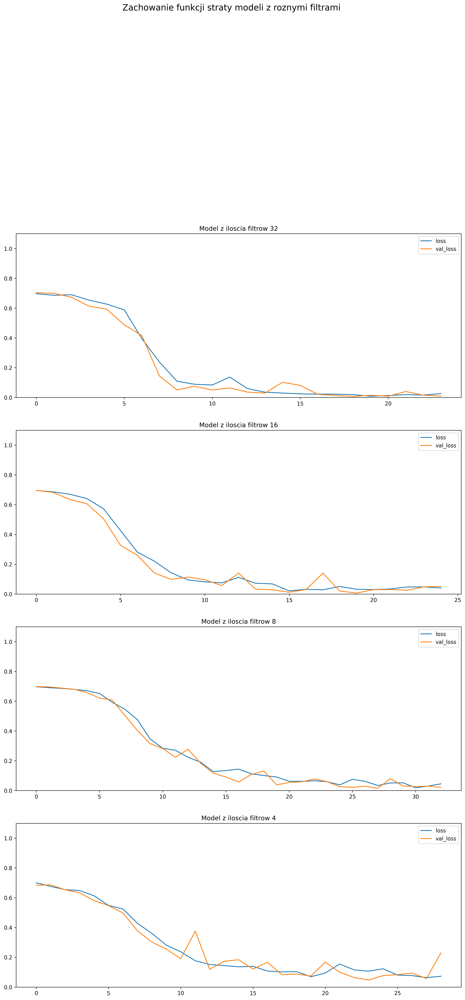

In [65]:
#LOS modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie funkcji straty modeli z roznymi filtrami', fontsize=16)
fig.set_dpi(300)
for indx, num_filtres in enumerate(ilosc_filtorw):
    metrics_df = pd.DataFrame( history_filtres[indx].history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["loss","val_loss"]])
    ax.legend(["loss","val_loss"])
    ax.set_title("Model z iloscia filtrow {}".format(num_filtres))
plt.show()
fig.savefig(porownanie_modeli_dir + 'Zachowanie funkcji straty modeli z roznymi filtrami.png')

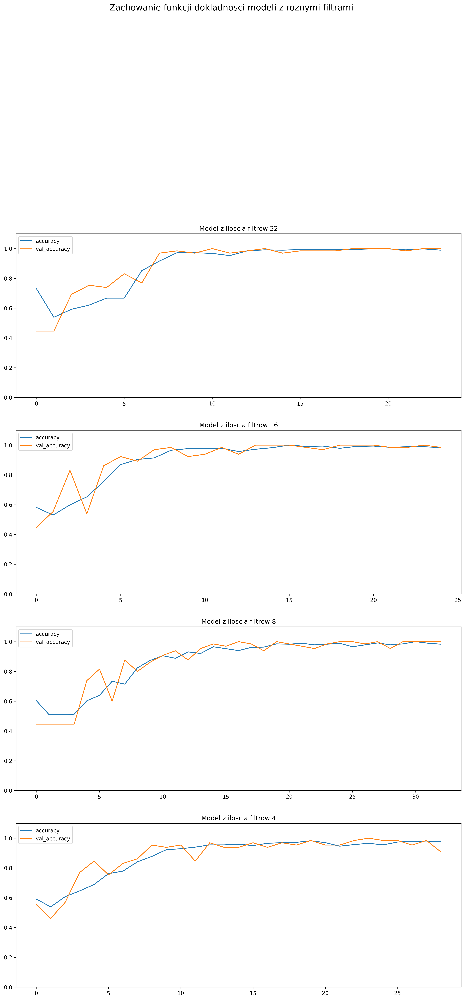

In [66]:
#Dokladonoas modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie funkcji dokladnosci modeli z roznymi filtrami', fontsize=16)
fig.set_dpi(300)
for indx, num_filtres in enumerate(ilosc_filtorw):
    metrics_df = pd.DataFrame( history_filtres[indx].history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["accuracy","val_accuracy"]])
    ax.legend(["accuracy","val_accuracy"])
    ax.set_title("Model z iloscia filtrow {}".format(num_filtres))
plt.show()
fig.savefig(porownanie_modeli_dir + 'Zachowanie funkcji dokladnosci modeli z roznymi filtrami.png')

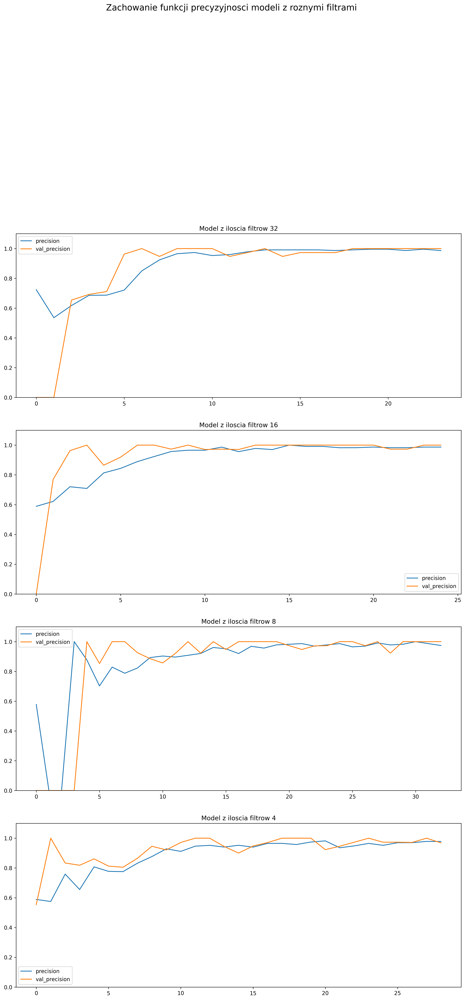

In [67]:
#Precyzyjnosc modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie funkcji precyzyjnosci modeli z roznymi filtrami', fontsize=16)
fig.set_dpi(300)
for indx, num_filtres in enumerate(ilosc_filtorw):
    metrics_df = pd.DataFrame( history_filtres[indx].history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["precision","val_precision"]])
    ax.legend(["precision","val_precision"])
    ax.set_title("Model z iloscia filtrow {}".format(num_filtres))
plt.show()
fig.savefig(porownanie_modeli_dir + 'Zachowanie funkcji precyzyjnosci modeli z roznymi filtrami.png')

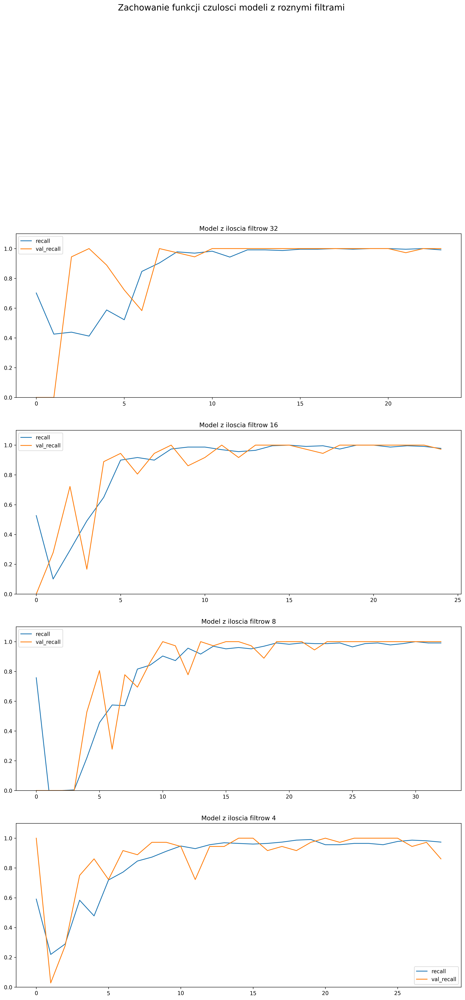

In [68]:
#Czulpsc modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie funkcji czulosci modeli z roznymi filtrami', fontsize=16)
fig.set_dpi(300)
for indx, num_filtres in enumerate(ilosc_filtorw):
    metrics_df = pd.DataFrame( history_filtres[indx].history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["recall","val_recall"]])
    ax.legend(["recall","val_recall"])
    ax.set_title("Model z iloscia filtrow {}".format(num_filtres))
plt.show()
fig.savefig(porownanie_modeli_dir + 'Zachowanie funkcji czulosci modeli z roznymi filtrami.png')

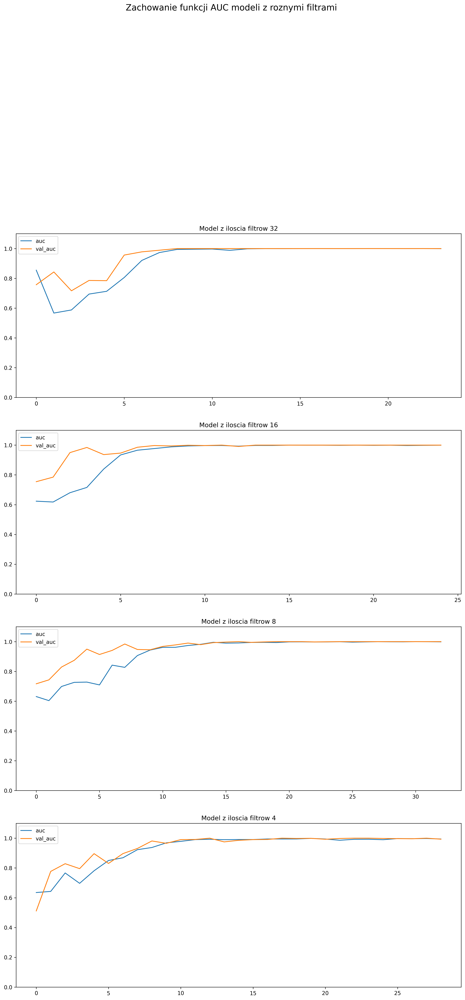

In [69]:
#AUC modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie funkcji AUC modeli z roznymi filtrami', fontsize=16)
fig.set_dpi(300)
for indx, num_filtres in enumerate(ilosc_filtorw):
    metrics_df = pd.DataFrame( history_filtres[indx].history)
    ax = plt.subplot(9, 1, indx + 1)
    ax.set(ylim =(0, 1.1))
    ax.plot(metrics_df[["auc","val_auc"]])
    ax.legend(["auc","val_auc"])
    ax.set_title("Model z iloscia filtrow {}".format(num_filtres))
plt.show()
fig.savefig(porownanie_modeli_dir + 'Zachowanie funkcji AUC modeli z roznymi filtrami.png')

## Zbior testowy 

In [70]:
# Evaluate the model on the test data using `evaluate`
for indx, num_filtres in enumerate(ilosc_filtorw):
    print("Liczba fitrow: {}".format(num_filtres))
    res = models_filtres[indx].evaluate(test_generator, batch_size=120)

Liczba fitrow: 32
2/2 [==============================] - 0s 15ms/step - loss: 0.0300 - accuracy: 0.9808 - precision: 1.0000 - recall: 0.9524 - auc: 1.0000
Liczba fitrow: 16
2/2 [==============================] - 0s 168ms/step - loss: 0.0165 - accuracy: 1.0000 - precision: 1.0000 - recall: 1.0000 - auc: 1.0000
Liczba fitrow: 8
2/2 [==============================] - 0s 148ms/step - loss: 0.0171 - accuracy: 1.0000 - precision: 1.0000 - recall: 1.0000 - auc: 1.0000
Liczba fitrow: 4
2/2 [==============================] - 0s 139ms/step - loss: 0.0892 - accuracy: 0.9808 - precision: 1.0000 - recall: 0.9524 - auc: 0.9954


In [71]:
fpr_models_filtres = []
tpr_models_filtres = []

for indx, model in enumerate(models_filtres):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_generator.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))


        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The model with {}  fitres True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(ilosc_filtorw[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models_filtres.append(fpr)
    tpr_models_filtres.append(tpr)

The model with 32  fitres True positive: 143 True negative: 251 False Positive: 0 False negative: 6

The model with 16  fitres True positive: 171 True negative: 226 False Positive: 3 False negative: 0

The model with 8  fitres True positive: 168 True negative: 229 False Positive: 3 False negative: 0

The model with 4  fitres True positive: 166 True negative: 228 False Positive: 2 False negative: 4



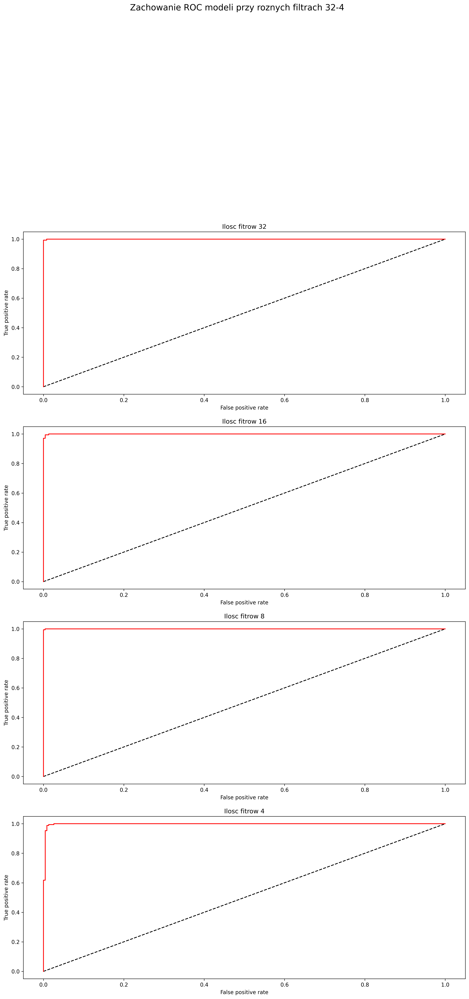

In [72]:
#ROC modeli
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modeli przy roznych filtrach 32-4', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models_filtres):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models_filtres[indx] , tpr_models_filtres[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Ilosc fitrow {}".format(ilosc_filtorw[indx]))
plt.show()
fig.savefig(porownanie_modeli_dir + 'Zachowanie ROC modeli przy roznych filtrach.png')

# Dane oddalone 10 w prawo

In [73]:
path_filtres_1 = porownanie_modeli_dir + "test_10_oddalone_w_prawo/"
test_filtres_1 = data_gen.flow_from_directory(path_filtres_1, **flow_parameters)

Found 433 images belonging to 2 classes.


In [74]:
fpr_models_filtres = []
tpr_models_filtres = []

for indx, model in enumerate(models_filtres):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_filtres_1.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))

        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The model with {}  fitres True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(ilosc_filtorw[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models_filtres.append(fpr)
    tpr_models_filtres.append(tpr)

The model with 32  fitres True positive: 223 True negative: 110 False Positive: 66 False negative: 1

The model with 16  fitres True positive: 219 True negative: 107 False Positive: 72 False negative: 2

The model with 8  fitres True positive: 226 True negative: 46 False Positive: 128 False negative: 0

The model with 4  fitres True positive: 210 True negative: 103 False Positive: 77 False negative: 10



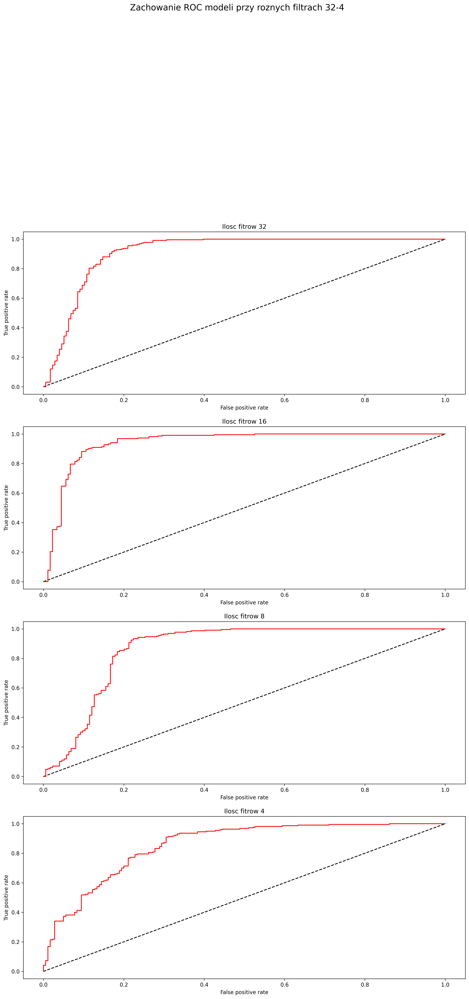

In [75]:
#ROC modeli 10 oddalone
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modeli przy roznych filtrach 32-4', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models_filtres):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models_filtres[indx] , tpr_models_filtres[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Ilosc fitrow {}".format(ilosc_filtorw[indx]))
plt.show()
fig.savefig(porownanie_modeli_dir + "test_10_oddalone_w_prawo/" + 'Zachowanie ROC modeli przy roznych filtrach 32-4.png')

## Dane oddalone 20 w prawo

In [76]:
path_filtres_2 = porownanie_modeli_dir + "test_20_oddalone_w_prawo/"
test_filtres_2 = data_gen.flow_from_directory(path_filtres_2, **flow_parameters)

Found 427 images belonging to 2 classes.


In [77]:
fpr_models_filtres = []
tpr_models_filtres = []

for indx, model in enumerate(models_filtres):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_filtres_2.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))

        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The model with {}  fitres True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(ilosc_filtorw[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models_filtres.append(fpr)
    tpr_models_filtres.append(tpr)


The model with 32  fitres True positive: 202 True negative: 34 False Positive: 160 False negative: 4

The model with 16  fitres True positive: 213 True negative: 48 False Positive: 138 False negative: 1

The model with 8  fitres True positive: 234 True negative: 4 False Positive: 162 False negative: 0

The model with 4  fitres True positive: 214 True negative: 64 False Positive: 114 False negative: 8



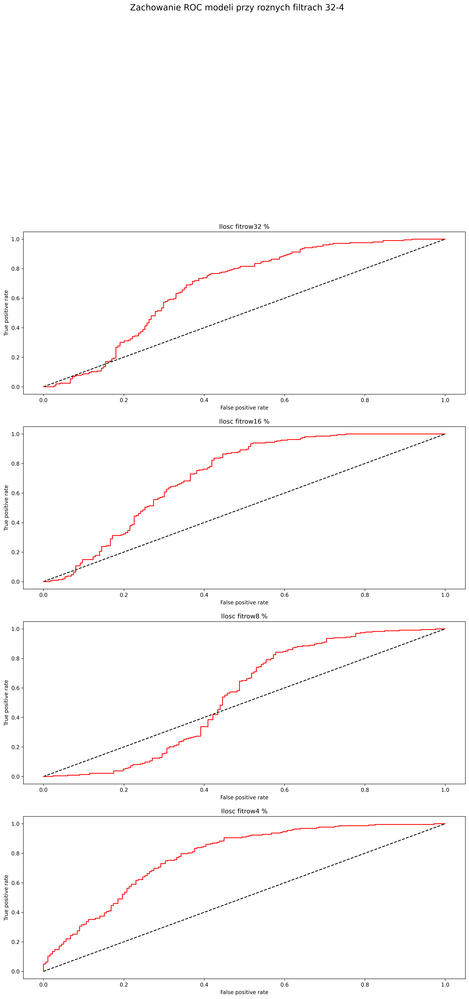

In [78]:
#ROC modeli 20 oddalone
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modeli przy roznych filtrach 32-4', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models_filtres):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models_filtres[indx] , tpr_models_filtres[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Ilosc fitrow{} %".format(ilosc_filtorw[indx]))
plt.show()
fig.savefig(porownanie_modeli_dir + "test_20_oddalone_w_prawo/" + 'Zachowanie ROC modeli przy roznych filtrach 32-4.png')

# Test brak prazkow

In [79]:
path_filtres_3 = porownanie_modeli_dir + "test_brak_prazkow/"
test_filtres_3 = data_gen.flow_from_directory(path_filtres_3, **flow_parameters)

Found 421 images belonging to 2 classes.


In [80]:
fpr_models_filtres = []
tpr_models_filtres = []

for indx, model in enumerate(models_filtres):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_filtres_3.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))

        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The model with {}  fitres True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(ilosc_filtorw[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models_filtres.append(fpr)
    tpr_models_filtres.append(tpr)


The model with 32  fitres True positive: 224 True negative: 169 False Positive: 3 False negative: 4

The model with 16  fitres True positive: 215 True negative: 146 False Positive: 39 False negative: 0

The model with 8  fitres True positive: 231 True negative: 147 False Positive: 22 False negative: 0

The model with 4  fitres True positive: 206 True negative: 137 False Positive: 48 False negative: 9



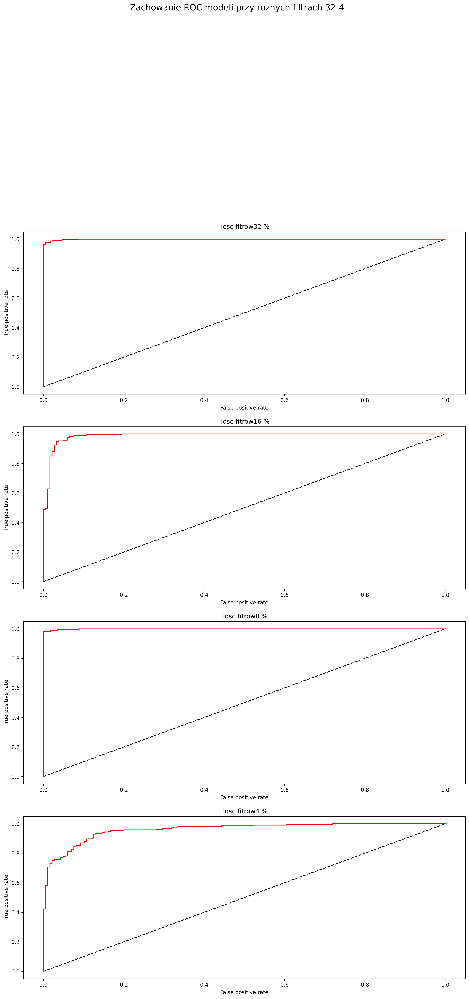

In [81]:
#ROC modeli bez prazkow
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modeli przy roznych filtrach 32-4', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models_filtres):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models_filtres[indx] , tpr_models_filtres[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Ilosc fitrow{} %".format(ilosc_filtorw[indx]))
plt.show()
fig.savefig(porownanie_modeli_dir + "test_brak_prazkow/" + 'Zachowanie ROC modeli przy roznych filtrach 32-4.png')

# Test jedna gwiazda

In [82]:
path_filtres_4 = porownanie_modeli_dir + "test_jedna_gwiazda/"
test_filtres_4 = data_gen.flow_from_directory(path_filtres_4, **flow_parameters)

Found 499 images belonging to 2 classes.


In [83]:
fpr_models_filtres = []
tpr_models_filtres = []

for indx, model in enumerate(models_filtres):
    tp = 0
    tn = 0
    fp = 0
    fn = 0
    threshold = 0.5
    y_predict = []
    y_true = []

    for _ in range(400):
        images, labels = test_filtres_4.next()
        class_info = int(labels[0])

        test_image_orginal = np.expand_dims(images[0].astype("uint8"), axis=0)
        prediction = model.predict(test_image_orginal)[0][0]
        y_predict.append(prediction)
        y_true.append(int(labels[0]))

        if prediction >= threshold:
            if class_info == 1:
                tp = tp + 1
            else:
                fp = fp + 1
        else:
            if class_info == 0:
                tn = tn + 1
            else:
                fn = fn + 1
    print("The model with {}  fitres True positive: {} True negative: {} False Positive: {} False negative: {}\n".format(ilosc_filtorw[indx], tp, tn, fp, fn))
    fpr, tpr, thresholds = roc_curve(y_true, y_predict)
    fpr_models_filtres.append(fpr)
    tpr_models_filtres.append(tpr)


The model with 32  fitres True positive: 163 True negative: 229 False Positive: 6 False negative: 2

The model with 16  fitres True positive: 174 True negative: 202 False Positive: 24 False negative: 0

The model with 8  fitres True positive: 188 True negative: 121 False Positive: 91 False negative: 0

The model with 4  fitres True positive: 177 True negative: 190 False Positive: 23 False negative: 10



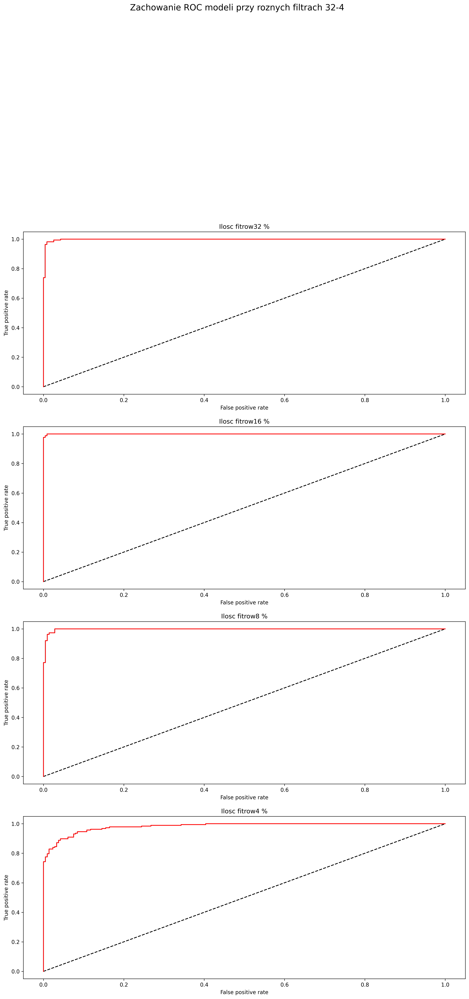

In [84]:
#ROC modeli bez prazkow
fig = plt.figure(figsize=(15, 60))
fig.suptitle('Zachowanie ROC modeli przy roznych filtrach 32-4', fontsize=16)
fig.set_dpi(300)
for indx, hist in enumerate(models_filtres):
    ax = plt.subplot(9, 1, indx + 1)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.plot(fpr_models_filtres[indx] , tpr_models_filtres[indx], 'r')
    ax.set_xlabel('False positive rate')
    ax.set_ylabel('True positive rate')
    ax.set_title("Ilosc fitrow{} %".format(ilosc_filtorw[indx]))
plt.show()
fig.savefig(porownanie_modeli_dir + "test_jedna_gwiazda/" + 'Zachowanie ROC modeli przy roznych filtrach 32-4.png')